# Bibliotecas

In [ ]:
import pandas as pd
from pathlib import Path
import locale
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import HeatMap

# Setando locale para en_US por conta das datas
locale.setlocale(locale.LC_ALL, 'en_US')

'en_US'

# Caminhos

In [2]:
CAMINHO_BASE_PRISOES = Path(r"C:\Users\felip\Documents\Arrest_Data_from_2020_to_Present.csv")
CAMINHO_BASE_CRIMES = Path(r"C:\Users\felip\Documents\Crime_Data_from_2020_to_Present.csv")
CAMINHO_BASE_LIGACOES_LAPD = Path(r"C:\Users\felip\Documents\LAPD_Calls_for_Service_2022.csv")

# DataFrame
## Leitura

In [3]:
df_crimes = pd.read_csv(CAMINHO_BASE_CRIMES, dtype=str)

## Tratamento

In [4]:
df_crimes_tratado = df_crimes.copy()

df_crimes_tratado = df_crimes_tratado.set_index('DR_NO')

df_crimes_tratado = df_crimes_tratado.drop_duplicates()

colunas_numericas = ('AREA', 'Crm Cd', 'Part 1-2', 'Vict Age', 'Premis Cd', 'Weapon Used Cd', 'Crm Cd 1', 'Crm Cd 2', 'Crm Cd 3', 'Crm Cd 4', 'LAT', 'LON')

for column in df_crimes_tratado.columns:
    if column in colunas_numericas:
        df_crimes_tratado[column] = pd.to_numeric(df_crimes_tratado[column], errors='coerce')
    else:
        df_crimes_tratado[column] = df_crimes_tratado[column].astype(dtype='category')

df_crimes_tratado['Date Rptd'] = pd.to_datetime(df_crimes_tratado['Date Rptd'], format="%m/%d/%Y", exact=False)
df_crimes_tratado['DATE OCC'] = pd.to_datetime(df_crimes_tratado['DATE OCC'], format="%m/%d/%Y", exact=False)

df_crimes_tratado = df_crimes_tratado.sort_index()

# Setando o locale para pt-BR
locale.setlocale(locale.LC_ALL, 'pt_BR')

# Criando colunas para análise posterior
df_crimes_tratado['ANO OCC'] = df_crimes_tratado['DATE OCC'].dt.year
df_crimes_tratado['MES OCC'] = df_crimes_tratado['DATE OCC'].dt.month
df_crimes_tratado['DIA SEMANA OCC'] = df_crimes_tratado['DATE OCC'].dt.day_of_week
df_crimes_tratado['HORA OCC'] = df_crimes_tratado['TIME OCC'].str[:2].astype(int)

# Análises Gerais
## 1. Visualização

In [57]:
df_crimes_tratado.head()

,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,Mocodes,...,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON,ANO OCC,MES OCC,DIA SEMANA OCC,HORA OCC
DR_NO,,,,,,,,,,,,,,,,,,,,,
010304468,2020-01-08,2020-01-08,2230,3,Southwest,0377,2,624,BATTERY - SIMPLE ASSAULT,0444 0913,...,NaN,NaN,1100 W 39TH PL,NaN,34.0141,-118.2978,2020,1,2,22
190101086,2020-01-02,2020-01-01,0330,1,Central,0163,2,624,BATTERY - SIMPLE ASSAULT,0416 1822 1414,...,NaN,NaN,700 S HILL ST,NaN,34.0459,-118.2545,2020,1,2,3
190101087,2020-01-02,2020-01-01,0510,1,Central,0156,2,626,INTIMATE PARTNER - SIMPLE ASSAULT,1414 1218 2000 1814 0416 0447,...,NaN,NaN,300 E 5TH ST,NaN,34.0447,-118.2452,2020,1,2,5
190326475,2020-03-01,2020-03-01,2130,7,Wilshire,0784,1,510,VEHICLE - STOLEN,NaN,...,NaN,NaN,1900 S LONGWOOD AV,NaN,34.0375,-118.3506,2020,3,6,21
191501505,2020-01-01,2020-01-01,1730,15,N Hollywood,1543,2,745,VANDALISM - MISDEAMEANOR ($399 OR UNDER),0329 1402,...,NaN,NaN,5400 CORTEEN PL,NaN,34.1685,-118.4019,2020,1,2,17


## 2. Info

In [58]:
df_crimes_tratado.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1002096 entries, 010304468 to 252104146
Data columns (total 31 columns):
 #   Column          Non-Null Count    Dtype         
---  ------          --------------    -----         
 0   Date Rptd       1002096 non-null  datetime64[ns]
 1   DATE OCC        1002096 non-null  datetime64[ns]
 2   TIME OCC        1002096 non-null  category      
 3   AREA            1002096 non-null  int64         
 4   AREA NAME       1002096 non-null  category      
 5   Rpt Dist No     1002096 non-null  category      
 6   Part 1-2        1002096 non-null  int64         
 7   Crm Cd          1002096 non-null  int64         
 8   Crm Cd Desc     1002096 non-null  category      
 9   Mocodes         851655 non-null   category      
 10  Vict Age        1002096 non-null  int64         
 11  Vict Sex        858594 non-null   category      
 12  Vict Descent    858582 non-null   category      
 13  Premis Cd       1002080 non-null  float64       
 14  Premis Desc  

## 3. Describe

In [59]:
df_crimes_tratado.describe()

,Date Rptd,DATE OCC,AREA,Part 1-2,Crm Cd,Vict Age,Premis Cd,Weapon Used Cd,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LAT,LON,ANO OCC,MES OCC,DIA SEMANA OCC,HORA OCC
count,1002096,1002096,1.002096e+06,1.002096e+06,1.002096e+06,1.002096e+06,1.002080e+06,326299.000000,1.002085e+06,69082.000000,2312.000000,64.00000,1.002096e+06,1.002096e+06,1.002096e+06,1.002096e+06,1.002096e+06,1.002096e+06
mean,2022-05-25 18:40:10.260094976,2022-05-13 14:21:08.802988288,1.069226e+01,1.400526e+00,5.000739e+02,2.898327e+01,3.056902e+02,364.026690,4.998340e+02,958.116123,984.003893,991.21875,3.399812e+01,-1.180905e+02,2.021878e+03,6.370048e+00,3.023428e+00,1.322184e+01
min,2020-01-01 00:00:00,2020-01-01 00:00:00,1.000000e+00,1.000000e+00,1.100000e+02,-4.000000e+00,1.010000e+02,101.000000,1.100000e+02,210.000000,310.000000,821.00000,0.000000e+00,-1.186676e+02,2.020000e+03,1.000000e+00,0.000000e+00,0.000000e+00
25%,2021-04-21 00:00:00,2021-04-06 00:00:00,5.000000e+00,1.000000e+00,3.310000e+02,0.000000e+00,1.010000e+02,311.000000,3.310000e+02,998.000000,998.000000,998.00000,3.401480e+01,-1.184305e+02,2.021000e+03,3.000000e+00,1.000000e+00,9.000000e+00
50%,2022-06-07 00:00:00,2022-05-26 00:00:00,1.100000e+01,1.000000e+00,4.420000e+02,3.000000e+01,2.030000e+02,400.000000,4.420000e+02,998.000000,998.000000,998.00000,3.405900e+01,-1.183225e+02,2.022000e+03,6.000000e+00,3.000000e+00,1.400000e+01
75%,2023-07-03 00:00:00,2023-06-21 00:00:00,1.600000e+01,2.000000e+00,6.260000e+02,4.400000e+01,5.010000e+02,400.000000,6.260000e+02,998.000000,998.000000,998.00000,3.416490e+01,-1.182739e+02,2.023000e+03,9.000000e+00,5.000000e+00,1.900000e+01
max,2025-06-04 00:00:00,2025-05-29 00:00:00,2.100000e+01,2.000000e+00,9.560000e+02,1.200000e+02,9.760000e+02,516.000000,9.560000e+02,999.000000,999.000000,999.00000,3.433430e+01,0.000000e+00,2.025000e+03,1.200000e+01,6.000000e+00,2.300000e+01
std,NaN,NaN,6.110122e+00,4.900054e-01,2.052795e+02,2.197829e+01,2.191396e+02,123.657622,2.050793e+02,110.347942,52.372013,27.06985,1.611947e+00,5.586689e+00,1.314819e+00,3.463529e+00,1.987157e+00,6.508995e+00


# Tabelas de-para (referências)

In [60]:
de_para_area = df_crimes_tratado[['AREA', 'AREA NAME']]
de_para_area = de_para_area.dropna(subset='AREA')
de_para_area = de_para_area.drop_duplicates()
de_para_area = de_para_area.set_index('AREA')
de_para_area = de_para_area.sort_values(by=['AREA'])

In [61]:
de_para_crimes = df_crimes_tratado[['Crm Cd', 'Crm Cd Desc']]
de_para_crimes = de_para_crimes.dropna(subset='Crm Cd')
de_para_crimes = de_para_crimes.drop_duplicates()
de_para_crimes = de_para_crimes.set_index('Crm Cd')
de_para_crimes = de_para_crimes.sort_values(by=['Crm Cd'])

In [62]:
de_para_sexo = pd.DataFrame({
    'Vict Sex Desc': ['Male', 'Female', 'Unknown']
}, index=['M', 'F', 'X'])
de_para_sexo.index.name = 'Vict Sex'

In [63]:
de_para_descendencia = pd.DataFrame({
    'Vict Descent Desc': ['Other Asian', 'Black', 'Chinese', 'Cambodian', 'Filipino', 'Guamanian', 'Hispanic/Latin/Mexican', 'American Indian/Alaskan Native', 'Japanese', 'Korean', 'Laotian', 'Other', 'Pacific Islander', 'Samoan', 'Hawaiian', 'Vietnamese', 'White', 'Unknown', 'Asian Indian']
}, index=['A', 'B', 'C', 'D', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'O', 'P', 'S', 'U', 'V', 'W', 'X', 'Z'])
de_para_descendencia.index.name = 'Vict Descent'

In [64]:
de_para_estabelecimento = df_crimes_tratado[['Premis Cd', 'Premis Desc']]
de_para_estabelecimento = de_para_estabelecimento.dropna(subset='Premis Cd')
de_para_estabelecimento = de_para_estabelecimento.astype({'Premis Cd': int})
de_para_estabelecimento = de_para_estabelecimento.drop_duplicates()
de_para_estabelecimento = de_para_estabelecimento.set_index('Premis Cd')
de_para_estabelecimento = de_para_estabelecimento.sort_values(by=['Premis Cd'])

In [65]:
de_para_armas = df_crimes_tratado[['Weapon Used Cd', 'Weapon Desc']]
de_para_armas = de_para_armas.dropna(subset='Weapon Used Cd')
de_para_armas = de_para_armas.astype({'Weapon Used Cd': int})
de_para_armas = de_para_armas.drop_duplicates()
de_para_armas = de_para_armas.set_index('Weapon Used Cd')
de_para_armas = de_para_armas.sort_values(by=['Weapon Used Cd'])

In [66]:
de_para_status = df_crimes_tratado[['Status', 'Status Desc']]
de_para_status = de_para_status.dropna(subset='Status')
de_para_status = de_para_status.drop_duplicates()
de_para_status = de_para_status.set_index('Status')
de_para_status = de_para_status.sort_values(by=['Status'])

# Análises
## Análises crimes x tempo
> Usando matplotlib.pyplot e seaborn
### Por ano

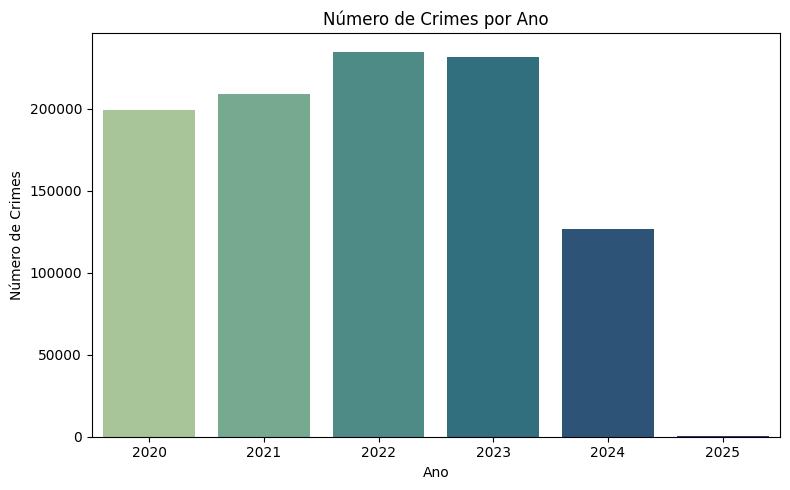

In [102]:
plt.figure(figsize=(8, 5))
sns.countplot(data=df_crimes_tratado, x='ANO OCC', hue='ANO OCC', palette='crest', legend=False)
plt.title('Número de Crimes por Ano')
plt.ylabel('Número de Crimes')
plt.xlabel('Ano')
plt.tight_layout()


### Por mês (agrupando todos os anos)

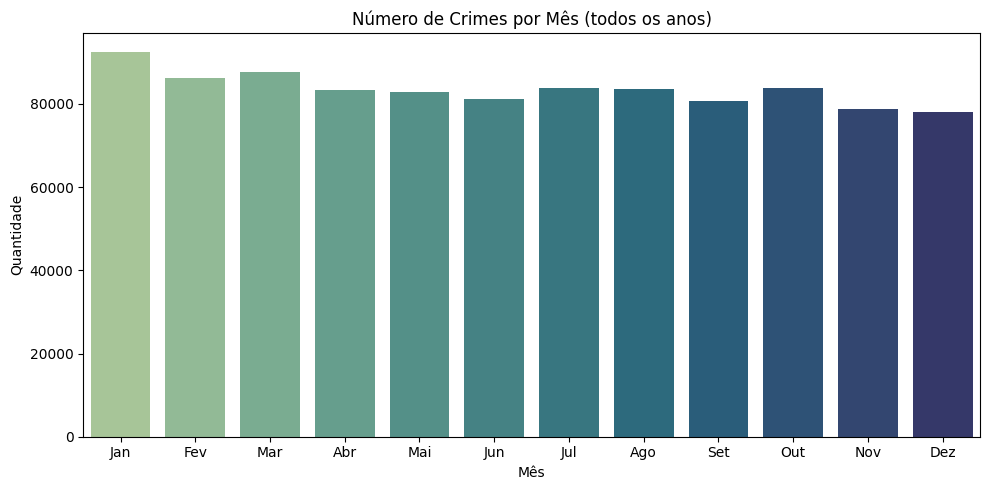

In [101]:
plt.figure(figsize=(10, 5))
sns.countplot(data=df_crimes_tratado, x='MES OCC', hue='MES OCC', palette='crest', legend=False)
plt.title('Número de Crimes por Mês (todos os anos)')
plt.xlabel('Mês')
plt.ylabel('Quantidade')
plt.xticks(range(12), [
    'Jan', 'Fev', 'Mar', 'Abr', 'Mai', 'Jun',
    'Jul', 'Ago', 'Set', 'Out', 'Nov', 'Dez'
])
plt.tight_layout()


### Por dia da semana (agrupando todos os meses e anos)

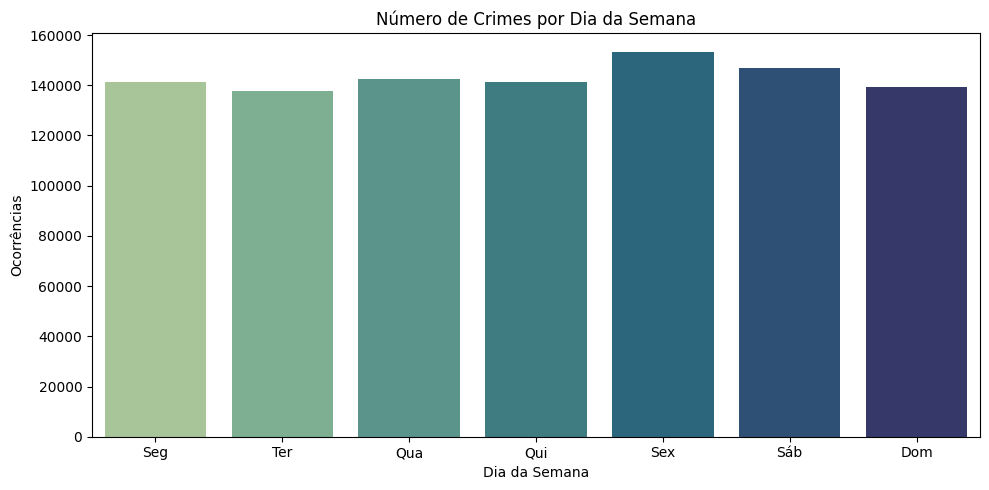

In [98]:
plt.figure(figsize=(10, 5))
sns.countplot(data=df_crimes_tratado, x='DIA SEMANA OCC', hue='DIA SEMANA OCC', palette='crest', legend=False)
plt.title('Número de Crimes por Dia da Semana')
plt.xlabel('Dia da Semana')
plt.ylabel('Ocorrências')
plt.xticks(range(7), ['Seg', 'Ter', 'Qua', 'Qui', 'Sex', 'Sáb', 'Dom'])
plt.tight_layout()

### Por hora do dia

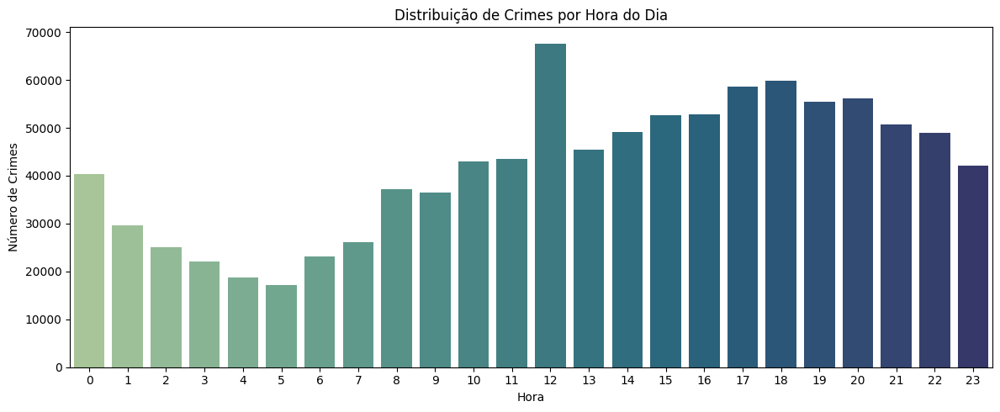

In [ ]:
plt.figure(figsize=(12, 5))
sns.countplot(data=df_crimes_tratado, x='HORA OCC', hue='HORA OCC', palette='crest', legend=False)
plt.title('Distribuição de Crimes por Hora do Dia')
plt.xlabel('Hora')
plt.ylabel('Número de Crimes')
plt.tight_layout()

## Análise geográfica

> Usando folium

### Mapa de calor geral

In [133]:
mapa = folium.Map(location=[34.0522, -118.2437], zoom_start=10)

coordenadas = df_crimes_tratado[['LAT', 'LON']]
coordenadas.dropna()

coordenadas = coordenadas.to_dict()
latitudes = coordenadas['LAT']
longitude = coordenadas['LON']

heat_data = list(zip(latitudes.values(), longitude.values()))

mapa_calor = HeatMap(heat_data, radius=8, blur=12)

mapa.add_child(mapa_calor)

### Mapa de calor para assaltos (assaults)

In [132]:
mapa_assaltos = folium.Map(location=[34.0522, -118.2437], zoom_start=10)

coordenadas_assaltos = df_crimes_tratado[df_crimes_tratado['Crm Cd Desc'].str.contains("ASSAULT", case=False, na=False)]

coordenadas_assaltos = coordenadas_assaltos.to_dict()
latitudes_assaltos = coordenadas_assaltos['LAT']
longitude_assaltos = coordenadas_assaltos['LON']

heat_data_assaltos = list(zip(latitudes.values(), longitude.values()))

mapa_calor_assaltos = HeatMap(heat_data_assaltos, radius=8, blur=10)

mapa_assaltos.add_child(mapa_calor_assaltos)

## Análises de tipo de crime

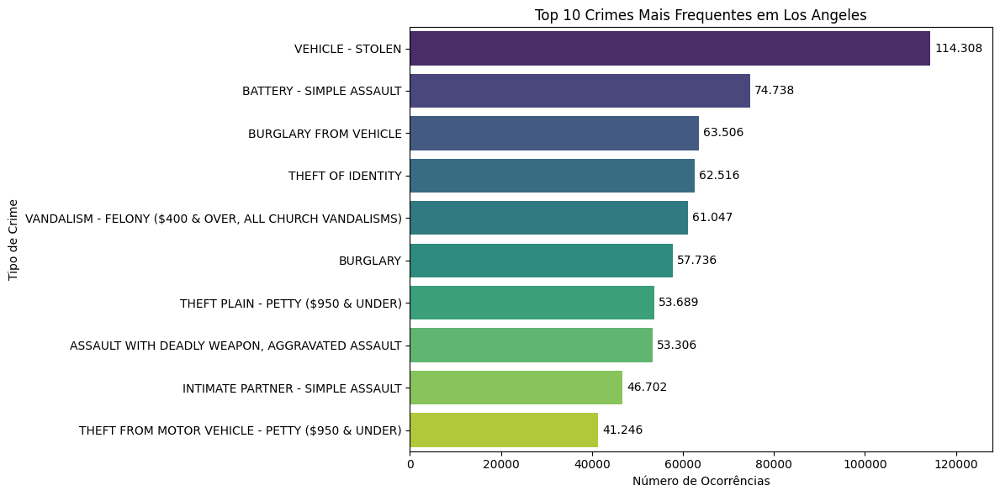

In [57]:
df_top10_crimes = (
    df_crimes_tratado['Crm Cd Desc']
    .value_counts()
    .head(10)
    .reset_index()
    .rename(columns={'Crm Cd Desc': 'Crime', 'count': 'Ocorrências'})
)

df_top10_crimes['Crime'] = pd.Categorical(df_top10_crimes['Crime'], categories=df_top10_crimes['Crime'].tolist(), ordered=True)

plt.figure(figsize=(12, 6))
ax = sns.barplot(data=df_top10_crimes, x='Ocorrências', y='Crime', hue='Crime', palette='viridis', legend=False)

for i, bar in enumerate(ax.patches):
    width = bar.get_width() # type: ignore
    ax.text(
        width + 1000,
        bar.get_y() + bar.get_height() / 2, # type: ignore
        f'{int(width):,}'.replace(',','.'),
        va='center'
    )

max_value = df_top10_crimes['Ocorrências'].max()
plt.xlim(0, max_value * 1.12)
plt.title('Top 10 Crimes Mais Frequentes em Los Angeles')
plt.xlabel('Número de Ocorrências')
plt.ylabel('Tipo de Crime')
plt.tight_layout()
plt.show()
